In [6]:
import os
import re
from glob import glob
import time
import random
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchmetrics
from torchmetrics.classification import MulticlassMatthewsCorrCoef
import open3d as o3
# from open3d import JVisualizer # For Colab Visualization
from open3d.web_visualizer import draw # for non Colab

import matplotlib.pyplot as plt

In [7]:
# TEMP for supressing pytorch user warnings
import warnings
warnings.filterwarnings("ignore")

In [8]:
# dataset
ROOT = os.path.dirname(os.getcwd()) + r'\Dataset\s3dis_Stanford3dDataset_v1.2_Reduced_Partitioned_Aligned_Version'

# feature selection hyperparameters
NUM_TRAIN_POINTS = 4096 # train/valid points
NUM_TEST_POINTS = 15000

BATCH_SIZE = 32

In [9]:
CATEGORIES = {
    'ceiling'  : 0, 
    'floor'    : 1, 
    'wall'     : 2, 
    'beam'     : 3, 
    'column'   : 4, 
    'window'   : 5,
    'door'     : 6, 
    'table'    : 7, 
    'chair'    : 8, 
    'sofa'     : 9, 
    'bookcase' : 10, 
    'board'    : 11,
    'stairs'   : 12,
    # 'clutter'  : 13
}

# unique color map generated via
# https://mokole.com/palette.html
COLOR_MAP = {
    0  : (47, 79, 79),    # ceiling - darkslategray
    1  : (139, 69, 19),   # floor - saddlebrown
    2  : (34, 139, 34),   # wall - forestgreen
    3  : (75, 0, 130),    # beam - indigo
    4  : (255, 0, 0),     # column - red 
    5  : (255, 255, 0),   # window - yellow
    6  : (0, 255, 0),     # door - lime
    7  : (0, 255, 255),   # table - aqua
    8  : (0, 0, 255),     # chair - blue
    9  : (255, 0, 255),   # sofa - fuchsia
    10 : (238, 232, 170), # bookcase - palegoldenrod
    11 : (100, 149, 237), # board - cornflower
    12 : (255, 105, 180), # stairs - hotpink
    # 13 : (0, 0, 0)        # clutter - black
}

v_map_colors = np.vectorize(lambda x : COLOR_MAP[x])

NUM_CLASSES = len(CATEGORIES)

In [10]:
from torch.utils.data import DataLoader
from s3dis_dataset import S3DIS

# get datasets
s3dis_train = S3DIS(ROOT, area_nums='1-4', npoints=NUM_TRAIN_POINTS, r_prob=0.25)
s3dis_valid = S3DIS(ROOT, area_nums='5', npoints=NUM_TRAIN_POINTS, r_prob=0.)
s3dis_test = S3DIS(ROOT, area_nums='6', split='test', npoints=NUM_TEST_POINTS)

# get dataloaders
train_dataloader = DataLoader(s3dis_train, batch_size=BATCH_SIZE, shuffle=True)
valid_dataloader = DataLoader(s3dis_valid, batch_size=BATCH_SIZE, shuffle=True)
test_dataloader = DataLoader(s3dis_test, batch_size=BATCH_SIZE, shuffle=False)


In [11]:
points, targets = s3dis_train[988]

pcd = o3.geometry.PointCloud()
pcd.points = o3.utility.Vector3dVector(points)
pcd.colors = o3.utility.Vector3dVector(np.vstack(v_map_colors(targets)).T/255)

# o3.visualization.draw_geometries([pcd])
o3.visualization.draw_plotly([pcd])

In [36]:
total_train_targets = []
for (_, targets) in train_dataloader:
    total_train_targets += targets.reshape(-1).numpy().tolist()

total_train_targets = np.array(total_train_targets)

In [37]:
class_bins = np.bincount(total_train_targets)
class_bins.shape

(13,)

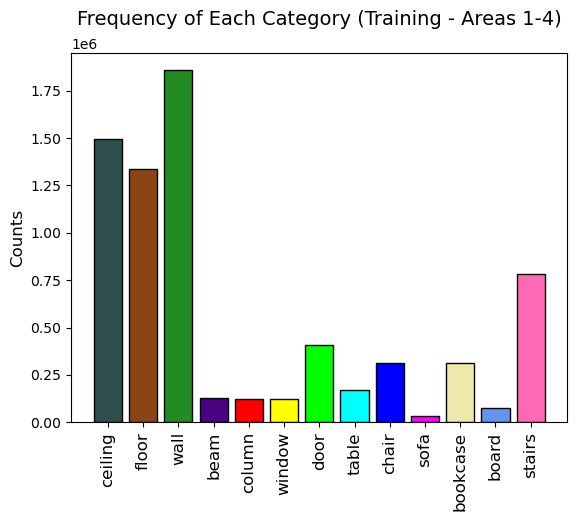

In [38]:
class_bins = np.bincount(total_train_targets)

plt.bar(list(CATEGORIES.keys()), class_bins, 
             color=[np.array(val)/255. for val in list(COLOR_MAP.values())],
             edgecolor='black')
plt.xticks(list(CATEGORIES.keys()), list(CATEGORIES.keys()), size=12, rotation=90)
plt.ylabel('Counts', size=12)
plt.title('Frequency of Each Category (Training - Areas 1-4)', size=14, pad=20);

In [41]:
from pointNetModel import PointNetSegHead

points, targets = next(iter(train_dataloader))

seg_model = PointNetSegHead(num_points=NUM_TRAIN_POINTS, m=NUM_CLASSES)
out, _, _ = seg_model(points.transpose(2, 1))
print(f'Seg shape: {out.shape}')

Seg shape: torch.Size([16, 4096, 13])


In [42]:
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
DEVICE

'cuda'

In [ ]:
# MODEL_PATH = 'seg_balanced/seg_model_15.pth'

# seg_model = PointNetSegHead(num_points=NUM_TRAIN_POINTS, m=NUM_CLASSES).to(DEVICE)
# seg_model.load_state_dict(torch.load(MODEL_PATH))

In [56]:
import torch.optim as optim
from point_net_loss import PointNetSegLoss

EPOCHS = 100
LR = 0.0001

# use inverse class weighting
# alpha = 1 / class_bins
# alpha = (alpha/alpha.max())

# manually set alpha weights
alpha = np.ones(len(CATEGORIES))
alpha[0:3] *= 0.25 # balance background classes
alpha[-1] *= 0.75  # balance clutter class

gamma = 1

optimizer = optim.Adam(seg_model.parameters(), lr=LR)
scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr=1e-6, max_lr=1e-3, 
                                              step_size_up=1000, cycle_momentum=False)
criterion = PointNetSegLoss(alpha=alpha, gamma=gamma, dice=True).to(DEVICE)

seg_model = seg_model.to(DEVICE)

In [52]:
mcc_metric = MulticlassMatthewsCorrCoef(num_classes=NUM_CLASSES).to(DEVICE)

In [53]:
def compute_iou(targets, predictions):

    targets = targets.reshape(-1)
    predictions = predictions.reshape(-1)

    intersection = torch.sum(predictions == targets) # true positives
    union = len(predictions) + len(targets) - intersection

    return intersection / union 

In [60]:
# store best validation iou
best_iou = 0.5
best_mcc = 0.5

# lists to store metrics
train_loss = []
train_accuracy = []
train_mcc = []
train_iou = []
valid_loss = []
valid_accuracy = []
valid_mcc = []
valid_iou = []

In [61]:
# stuff for training
num_train_batch = int(np.ceil(len(s3dis_train)/BATCH_SIZE))
num_valid_batch = int(np.ceil(len(s3dis_valid)/BATCH_SIZE))

for epoch in range(1, EPOCHS + 1):
    # place model in training mode
    seg_model = seg_model.train()
    _train_loss = []
    _train_accuracy = []
    _train_mcc = []
    _train_iou = []
    for i, (points, targets) in enumerate(train_dataloader, 0):

        points = points.transpose(2, 1).to(DEVICE)
        targets = targets.squeeze().to(DEVICE)
        
        # zero gradients
        optimizer.zero_grad()
        
        # get predicted class logits
        preds, _, _ = seg_model(points)

        # get class predictions
        pred_choice = torch.softmax(preds, dim=2).argmax(dim=2)

        # get loss and perform backprop
        loss = criterion(preds, targets, pred_choice) 
        loss.backward()
        optimizer.step()
        scheduler.step() # update learning rate
        
        # get metrics
        correct = pred_choice.eq(targets.data).cpu().sum()
        accuracy = correct/float(BATCH_SIZE*NUM_TRAIN_POINTS)
        mcc = mcc_metric(preds.transpose(2, 1), targets)
        iou = compute_iou(targets, pred_choice)

        # update epoch loss and accuracy
        _train_loss.append(loss.item())
        _train_accuracy.append(accuracy)
        _train_mcc.append(mcc.item())
        _train_iou.append(iou.item())

        if i % 100 == 0:
            print(f'\t [{epoch}: {i}/{num_train_batch}] ' \
                  + f'train loss: {loss.item():.4f} ' \
                  + f'accuracy: {accuracy:.4f} ' \
                  + f'mcc: {mcc:.4f} ' \
                  + f'iou: {iou:.4f}')
        
    train_loss.append(np.mean(_train_loss))
    train_accuracy.append(np.mean(_train_accuracy))
    train_mcc.append(np.mean(_train_mcc))
    train_iou.append(np.mean(_train_iou))

    print(f'Epoch: {epoch} - Train Loss: {train_loss[-1]:.4f} ' \
          + f'- Train Accuracy: {train_accuracy[-1]:.4f} ' \
          + f'- Train MCC: {train_mcc[-1]:.4f} ' \
          + f'- Train IOU: {train_iou[-1]:.4f}')

    # pause to cool down
    time.sleep(1)

    # get test results after each epoch
    with torch.no_grad():

        # place model in evaluation mode
        seg_model = seg_model.eval()

        _valid_loss = []
        _valid_accuracy = []
        _valid_mcc = []
        _valid_iou = []
        for i, (points, targets) in enumerate(valid_dataloader, 0):

            points = points.transpose(2, 1).to(DEVICE)
            targets = targets.squeeze().to(DEVICE)

            preds, _, A = seg_model(points)
            pred_choice = torch.softmax(preds, dim=2).argmax(dim=2)

            loss = criterion(preds, targets, pred_choice) 

            # get metrics
            correct = pred_choice.eq(targets.data).cpu().sum()
            accuracy = correct/float(BATCH_SIZE*NUM_TRAIN_POINTS)
            mcc = mcc_metric(preds.transpose(2, 1), targets)
            iou = compute_iou(targets, pred_choice)

            # update epoch loss and accuracy
            _valid_loss.append(loss.item())
            _valid_accuracy.append(accuracy)
            _valid_mcc.append(mcc.item())
            _valid_iou.append(iou.item())

            if i % 100 == 0:
                print(f'\t [{epoch}: {i}/{num_valid_batch}] ' \
                  + f'valid loss: {loss.item():.4f} ' \
                  + f'accuracy: {accuracy:.4f} '
                  + f'mcc: {mcc:.4f} ' \
                  + f'iou: {iou:.4f}')
        
        valid_loss.append(np.mean(_valid_loss))
        valid_accuracy.append(np.mean(_valid_accuracy))
        valid_mcc.append(np.mean(_valid_mcc))
        valid_iou.append(np.mean(_valid_iou))
        print(f'Epoch: {epoch} - Valid Loss: {valid_loss[-1]:.4f} ' \
              + f'- Valid Accuracy: {valid_accuracy[-1]:.4f} ' \
              + f'- Valid MCC: {valid_mcc[-1]:.4f} ' \
              + f'- Valid IOU: {valid_iou[-1]:.4f}')


        # pause to cool down
        time.sleep(4)

    # save best models
    # os.makedirs(f'trained_models/seg_focal_dice_iou_rot_clr', exist_ok=True)
    if valid_iou[-1] >= best_iou:
        best_iou = valid_iou[-1]
        torch.save(seg_model.state_dict(), f'trained_models/seg_focal_dice_iou_rot_clr/seg_model_{epoch}_iou_{best_iou}.pth')

    # if valid_mcc[-1] >= best_mcc:
    #     best_mcc = valid_mcc[-1]
    #     torch.save(seg_model.state_dict(), f'trained_models/seg_focal_dice_mcc/seg_model_{epoch}.pth')

	 [1: 0/55] train loss: 0.4395 accuracy: 0.7920 mcc: 0.7480 iou: 0.6556
Epoch: 1 - Train Loss: 0.3992 - Train Accuracy: 0.8010 - Train MCC: 0.7678 - Train IOU: 0.6771
	 [1: 0/27] valid loss: 0.6892 accuracy: 0.7287 mcc: 0.6739 iou: 0.5732
Epoch: 1 - Valid Loss: 1.5878 - Valid Accuracy: 0.6926 - Valid MCC: 0.6601 - Valid IOU: 0.5617
	 [2: 0/55] train loss: 0.3284 accuracy: 0.8344 mcc: 0.7999 iou: 0.7158
Epoch: 2 - Train Loss: 0.4099 - Train Accuracy: 0.7964 - Train MCC: 0.7621 - Train IOU: 0.6710
	 [2: 0/27] valid loss: 0.8171 accuracy: 0.7157 mcc: 0.6480 iou: 0.5573
Epoch: 2 - Valid Loss: 1.5175 - Valid Accuracy: 0.7190 - Valid MCC: 0.6817 - Valid IOU: 0.5883
	 [3: 0/55] train loss: 0.4705 accuracy: 0.7888 mcc: 0.7480 iou: 0.6513
Epoch: 3 - Train Loss: 0.4006 - Train Accuracy: 0.7988 - Train MCC: 0.7654 - Train IOU: 0.6745
	 [3: 0/27] valid loss: 0.7337 accuracy: 0.7439 mcc: 0.6892 iou: 0.5923
Epoch: 3 - Valid Loss: 2.0693 - Valid Accuracy: 0.6903 - Valid MCC: 0.6519 - Valid IOU: 0.552

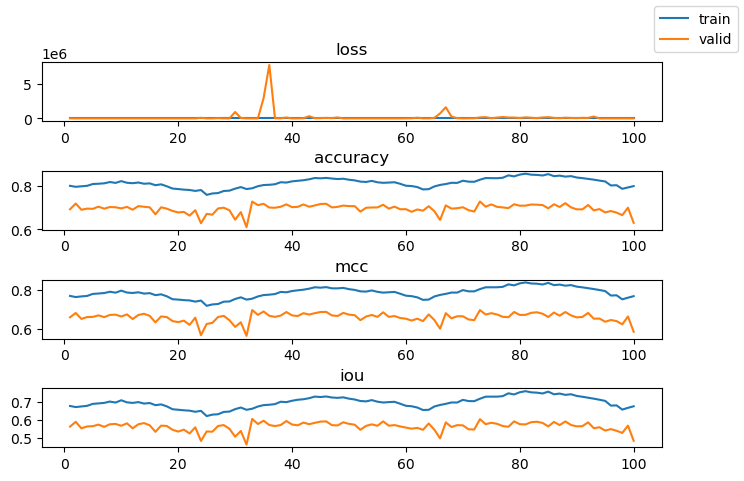

In [63]:
fig, ax = plt.subplots(4, 1, figsize=(8, 5))
ax[0].plot(np.arange(1, EPOCHS + 1), train_loss, label='train')
ax[0].plot(np.arange(1, EPOCHS + 1), valid_loss, label='valid')
ax[0].set_title('loss')

ax[1].plot(np.arange(1, EPOCHS + 1), train_accuracy)
ax[1].plot(np.arange(1, EPOCHS + 1), valid_accuracy)
ax[1].set_title('accuracy')

ax[2].plot(np.arange(1, EPOCHS + 1), train_mcc)
ax[2].plot(np.arange(1, EPOCHS + 1), valid_mcc)
ax[2].set_title('mcc')

ax[3].plot(np.arange(1, EPOCHS + 1), train_iou)
ax[3].plot(np.arange(1, EPOCHS + 1), valid_iou)
ax[3].set_title('iou')

fig.legend(loc='upper right')
plt.subplots_adjust(wspace=0., hspace=0.85)

In [64]:
MODEL_PATH = 'trained_models\seg_focal_dice_iou_rot_clr\seg_model_33_iou_0.6047836564205311.pth'

model = PointNetSegHead(num_points=NUM_TEST_POINTS, m=NUM_CLASSES).to(DEVICE)
model.load_state_dict(torch.load(MODEL_PATH))
model.eval();

In [65]:
num_test_batch = int(np.ceil(len(s3dis_test)/BATCH_SIZE))

total_test_targets = []
total_test_preds = [] 

with torch.no_grad():

    # place model in evaluation mode
    model = model.eval()

    test_loss = []
    test_accuracy = []
    test_mcc = []
    test_iou = []
    for i, (points, targets) in enumerate(test_dataloader, 0):

        points = points.transpose(2, 1).to(DEVICE)
        targets = targets.squeeze().to(DEVICE)

        preds, _, A = model(points)
        pred_choice = torch.softmax(preds, dim=2).argmax(dim=2)

        loss = criterion(preds, targets, pred_choice)

        # get metrics
        correct = pred_choice.eq(targets.data).cpu().sum()
        accuracy = correct/float(BATCH_SIZE*NUM_TEST_POINTS)
        mcc = mcc_metric(preds.transpose(2, 1), targets)
        iou = compute_iou(targets, pred_choice)

        # update epoch loss and accuracy
        test_loss.append(loss.item())
        test_accuracy.append(accuracy)
        test_mcc.append(mcc.item())
        test_iou.append(iou.item())

        # add to total targets/preds
        total_test_targets += targets.reshape(-1).cpu().numpy().tolist()
        total_test_preds += pred_choice.reshape(-1).cpu().numpy().tolist()

        if i % 50 == 0:
            print(f'\t [{i}/{num_test_batch}] ' \
                  + f'test loss: {loss.item():.4f} ' \
                  + f'accuracy: {accuracy:.4f} ' \
                  + f'mcc: {mcc:.4f} ' \
                  + f'iou: {iou:.4f}')

	 [0/13] test loss: 0.6862 accuracy: 0.7402 mcc: 0.6946 iou: 0.5876


In [66]:
# display test results
print(f'Test Loss: {np.mean(test_loss):.4f} ' \
        + f'- Test Accuracy: {np.mean(test_accuracy):.4f} ' \
        + f'- Test MCC: {np.mean(test_mcc):.4f} ' \
        + f'- Test IOU: {np.mean(test_iou):.4f}')

Test Loss: 0.6184 - Test Accuracy: 0.7391 - Test MCC: 0.7101 - Test IOU: 0.6141


In [67]:
total_test_targets = np.array(total_test_targets)
total_test_preds = np.array(total_test_preds)

In [68]:
from sklearn.metrics import confusion_matrix

test_confusion = pd.DataFrame(confusion_matrix(total_test_targets, total_test_preds),
                              columns=list(CATEGORIES.keys()),
                              index=list(CATEGORIES.keys()))

test_confusion

,ceiling,floor,wall,beam,column,window,door,table,chair,sofa,bookcase,board,stairs
ceiling,1122055,273,18872,3394,240,331,1195,0,0,0,1569,19,14744
floor,4420,945777,5992,0,0,0,192,0,0,0,13,0,30
wall,24167,12325,1287287,16927,9526,46800,55194,1176,100,0,18181,7635,32885
beam,19404,0,27144,132215,777,0,7813,0,0,0,3848,0,58613
column,741,1794,67824,0,46263,199,18021,59,457,0,98,112,11913
window,247,0,40641,480,134,105324,600,116,0,0,465,52,1867
door,0,4007,115878,4363,668,0,180304,0,0,0,268,298,3044
table,0,5696,20877,0,1010,544,1106,169430,35254,428,5126,0,82830
chair,0,14145,3782,0,285,0,2556,17268,133912,0,2731,123,40047
sofa,0,1601,782,0,8,0,267,471,12080,8686,481,6,4551


In [118]:
torch.cuda.empty_cache() # release GPU memory
points, targets = s3dis_test.get_random_partitioned_space()

# place on device
points = points.to(DEVICE)
targets = targets.to(DEVICE)

# Normalize each partitioned Point Cloud to (0, 1)
norm_points = points.clone()
norm_points = norm_points - norm_points.min(axis=1)[0].unsqueeze(1)
norm_points /= norm_points.max(axis=1)[0].unsqueeze(1)

with torch.no_grad():

    # prepare data
    norm_points = norm_points.transpose(2, 1)
    targets = targets.squeeze()

    # run inference
    preds, crit_idxs, _ = model(norm_points)

    # get metrics
    pred_choice = torch.softmax(preds, dim=2).argmax(dim=2)

    loss = criterion(preds, targets, pred_choice)
    correct = pred_choice.eq(targets.data).cpu().sum()
    accuracy = correct/float(points.shape[0]*NUM_TEST_POINTS)
    mcc = mcc_metric(preds.transpose(2, 1), targets)
    iou = compute_iou(targets, pred_choice)

print(f'Loss: {loss:.4f} - Accuracy: {accuracy:.4f} - MCC: {mcc:.4f} - IOU: {iou:.4f}')

Loss: 0.5783 - Accuracy: 0.7541 - MCC: 0.7116 - IOU: 0.6053


In [119]:
# display true full point cloud
pcd = o3.geometry.PointCloud()
pcd.points = o3.utility.Vector3dVector(points.permute(2, 0, 1).reshape(3, -1).to('cpu').T)
pcd.colors = o3.utility.Vector3dVector(np.vstack(v_map_colors(targets.reshape(-1).to('cpu'))).T/255)

pcd1 = o3.geometry.PointCloud()
pcd1.points = o3.utility.Vector3dVector(points.permute(2, 0, 1).reshape(3, -1).to('cpu').T)
pcd1.colors = o3.utility.Vector3dVector(np.vstack(v_map_colors(pred_choice.reshape(-1).to('cpu'))).T/255)
# draw(pcd)
# o3.visualization.draw_geometries([pcd])
o3.visualization.draw_plotly([pcd])

In [120]:
o3.visualization.draw_plotly([pcd1])

In [ ]:
pcds = []
crit_pcds = []
for i in range(points.shape[0]):
    
    pts = points[i, :]
    cdx = crit_idxs[i, :]
    tgt = targets[i, :]

    # get full point clouds
    pcd = o3.geometry.PointCloud()
    pcd.points = o3.utility.Vector3dVector(pts.to('cpu'))
    pcd.colors = o3.utility.Vector3dVector(np.vstack(v_map_colors(tgt.to('cpu'))).T/255)

    # get critical set point clouds
    critical_points = pts[cdx, :]
    critical_point_colors = np.vstack(v_map_colors(tgt[cdx].to('cpu'))).T/255

    crit_pcd = o3.geometry.PointCloud()
    crit_pcd.points = o3.utility.Vector3dVector(critical_points.to('cpu'))
    crit_pcd.colors = o3.utility.Vector3dVector(critical_point_colors)

    pcds.append(pcd)
    crit_pcds.append(crit_pcd)

o3.visualization.draw_plotly([crit_pcd])

In [111]:
critical_point_colors.shape

(1024, 3)

In [104]:
a = points.permute(2, 0, 1).reshape(3, -1).to('cpu').T
a.shape

torch.Size([90000, 3])

In [128]:
torch.cuda.get_device_capability(torch.cuda.get_device_name)

(8, 6)